In [ ]:
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
from torch.utils.data import Subset

import matplotlib.pyplot as plt
import numpy as np

import torchvision
import torchvision.datasets as DS
import torchvision.transforms as transforms
from torchvision.utils import make_grid
from torch.utils.data import random_split, DataLoader

In [ ]:
from torchvision import datasets, transforms
from torch.utils.data import Dataset

class CIFAR10GrayColorPair(Dataset):
    def __init__(self, root, train=True, download=True, transform=None):
        self.color_transform = transforms.Compose([
            transforms.ToTensor(),
            transforms.Resize(256),
            transforms.CenterCrop(224),
            transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
        ])
        self.gray_transform = transforms.Compose([
            transforms.Grayscale(num_output_channels=1),
            transforms.Resize(256),
            transforms.CenterCrop(224),
            transforms.ToTensor(),
            transforms.Normalize((0.5,), (0.5,))
        ])
        # Load CIFAR-10 dataset
        # self.color_dataset = datasets.CIFAR10(root=root, train=train, download=download, transform=self.color_transform)
        # self.gray_dataset = datasets.CIFAR10(root=root, train=train, download=False, transform=self.gray_transform)

        # Load Flowers dataset
        if train:
            self.color_dataset = datasets.Flowers102(root='data/', split='train',download=True, transform=self.color_transform)
            self.gray_dataset = datasets.Flowers102(root='data/', split='train', download=False, transform=self.gray_transform)
        else:
            self.color_dataset = datasets.Flowers102(root='data/', split='test',download=True, transform=self.color_transform)
            self.gray_dataset = datasets.Flowers102(root='data/', split='test', download=False, transform=self.gray_transform)

    def __getitem__(self, index):
        # Get the color image and its corresponding gray image
        color_img, _ = self.color_dataset[index]
        gray_img, _ = self.gray_dataset[index]

        return gray_img, color_img

    def __len__(self):
        return len(self.color_dataset)

# Usage
root = './data'
transform = transforms.Compose([
    transforms.ToTensor(),  # Add other transformations as needed
])
# test_dataset = CIFAR10GrayColorPair(root=root, train=True, download=True, transform=transform)
cifar10_gray_color_pair_dataset = CIFAR10GrayColorPair(root=root, train=True, download=True, transform=transform)

100%|██████████| 344862509/344862509 [00:16<00:00, 20507342.95it/s]


Extracting data/flowers-102/102flowers.tgz to data/flowers-102


100%|██████████| 502/502 [00:00<00:00, 505289.32it/s]


100%|██████████| 14989/14989 [00:00<00:00, 9964879.17it/s]


In [ ]:
len(cifar10_gray_color_pair_dataset)

1020

In [ ]:
torch.manual_seed(42)

In [ ]:
# Split the dataset into train and validation sets
train_size = 900
validation_size = 120
train_dataset, validation_dataset = random_split(cifar10_gray_color_pair_dataset, [train_size, validation_size])

In [ ]:
# Split the dataset into train and validation sets
validation_size = 60
test_size=60
validation_dataset, test_dataset = random_split(validation_dataset, [validation_size, test_size])

In [ ]:
# Dataloader to load batches of data
batch_size = 64
# You can create DataLoader instances to iterate over these datasets if needed
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
validation_loader = DataLoader(validation_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

In [ ]:
#complete the code
class UNet(nn.Module):
    def __init__(self, kernel, num_filters, num_colours=3, num_in_channels=1):
        super().__init__()

        padding = kernel // 2

        self.downconv1 = nn.Sequential(
            nn.Conv2d(1, num_filters, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters),
            nn.ReLU())

        # out: n x 32 x 32
        # out1: n x 16 x 16

        self.downconv2 = nn.Sequential(
            nn.Conv2d(num_filters, num_filters*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.ReLU())

        # out2: 2n x  16 x 16
        # out3: 2n x  8 x 8

        self.downconv3 = nn.Sequential(
            nn.Conv2d(num_filters*2, num_filters*4, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*4),
            nn.ReLU())

        # out4: 4n x  8 x 8
        # out5: 4n x  4 x 4


        self.rfconv = nn.Sequential(
            nn.Conv2d(num_filters*4, num_filters*8, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*8),
            nn.ReLU())

        # out6: 8n x  4 x 4
        # out7: 8n x  2 x 2

        self.maxp=nn.MaxPool2d(2)

        self.final_act = nn.Tanh()

        self.upconv=nn.Sequential(
            nn.Conv2d(num_filters*8, num_filters*8, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*8),
            nn.ReLU(),
            nn.Upsample(scale_factor=2))

        # out8: 4n x  4 x 4

        # skip connection decoder layer
        self.skip = nn.Sequential(
            nn.Conv2d(num_filters*16, num_filters*4, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*4),
            nn.ReLU(),
            nn.Upsample(scale_factor=2))

        # out8+out6: 16n x 4 x 4
        # outskip1: 4n x 8 x 8

        self.skip1 = nn.Sequential(
            nn.Conv2d(num_filters*8, num_filters*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.ReLU(),
            nn.Upsample(scale_factor=2))

        # outskip1+out4: 8n x 8 x 8
        # outskip2: 2n x 16 x 16

        self.skip2 = nn.Sequential(
            nn.Conv2d(num_filters*4, num_filters, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters),
            nn.ReLU(),
            nn.Upsample(scale_factor=2))

        # outskip2+out2:  4n x 16 x 16
        # outskip3: n x 32 x 32

        self.skip3 = nn.Sequential(
            nn.Conv2d(num_filters*2, 4, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(4),
            nn.ReLU())

        # outskip3+out: 2n x 32 x 32
        # outskip3: 3 x 32 x 32

        self.skip4 = nn.Sequential(
            nn.Conv2d(4, 3, kernel_size=kernel, padding=padding))

        # out: 2 x 32 x 32
        self.final_act = nn.Tanh()
    def forward(self, x):

        # 1x32x32

        out = self.downconv1(x) # nx32x32
        out1=self.maxp(out) # nx16x16

        out2 = self.downconv2(out1) # 2nx16x16
        out3=self.maxp(out2) # 2nx8x8

        out4 = self.downconv3(out3) # 4nx8x8
        out5=self.maxp(out4) # 4nx4x4

        out6 = self.rfconv(out5) # 8nx4x4
        out7=self.maxp(out6)  #8n x2x2

        out8=self.upconv(out7) #8n x4x4

        #16n x4x4
        out_skip1=self.skip(torch.cat((out8,out6),dim=1))
        #4n x8x8

        #8n x8x8
        out_skip2=self.skip1(torch.cat((out4,out_skip1),dim=1))
        #8n x16x16

        #4n x16x16
        out_skip3=self.skip2(torch.cat((out2,out_skip2),dim=1))
        #n x32x32

        #2n x32x32
        out_skip4=self.skip3(torch.cat((out,out_skip3),dim=1))
        #3 x32x32

        out=self.skip4(out_skip4)

        out=self.final_act(out)
        return out


In [ ]:
from torchsummary import summary
model=UNet(3,32)
model=model.to('cuda')
summary(model,(1,256,256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 256, 256]             320
       BatchNorm2d-2         [-1, 32, 256, 256]              64
              ReLU-3         [-1, 32, 256, 256]               0
         MaxPool2d-4         [-1, 32, 128, 128]               0
            Conv2d-5         [-1, 64, 128, 128]          18,496
       BatchNorm2d-6         [-1, 64, 128, 128]             128
              ReLU-7         [-1, 64, 128, 128]               0
         MaxPool2d-8           [-1, 64, 64, 64]               0
            Conv2d-9          [-1, 128, 64, 64]          73,856
      BatchNorm2d-10          [-1, 128, 64, 64]             256
             ReLU-11          [-1, 128, 64, 64]               0
        MaxPool2d-12          [-1, 128, 32, 32]               0
           Conv2d-13          [-1, 256, 32, 32]         295,168
      BatchNorm2d-14          [-1, 256,

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import torch

def imshow(img, is_gray=False):
    # Undo normalization
    img = img * 0.5 + 0.5
    npimg = img.numpy()

    if is_gray:
        plt.imshow(np.transpose(npimg, (1, 2, 0)).squeeze(), cmap='gray')
    else:
        plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.axis('off')

def display_predictions(grayscale, sample_color, predicted, n=5):
    #plt.figure(figsize=(15, 10))

    for i in range(n):
        plt.subplot(3, n, i + 1)  # Display grayscale images in the first row
        imshow(grayscale[i].cpu(), True)

        plt.subplot(3, n, i + 1 + n)  # Display sample color images in the second row
        imshow(sample_color[i].cpu())  # Assuming sample_color images are already in CPU and normalized

        plt.subplot(3, n, i + 1 + 2 * n)  # Display predicted color images in the third row
        imshow(predicted[i].cpu())  # Assuming predicted images are already in CPU and normalized

    plt.show()

In [ ]:
def test_unet(loader):

  losses=0
  for i, (xs, ys) in enumerate(loader):

          images=xs.cuda()
          labels=ys.cuda()
          outputs = model(images)
          loss = criterion(outputs, labels)
          losses+=loss.item()
  return losses/len(loader);

In [ ]:
def plot_losses_unet(epochs,train_losses,test_losses, valid_losses):

    epochs = list(range(1, epochs + 1))
    plt.figure(figsize=(10, 6))
    plt.plot(epochs, train_losses, label='Training')
    plt.plot(epochs, test_losses, label='Testing ')
    plt.plot(epochs, valid_losses, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    #plt.show()

In [ ]:
data_iter = iter(validation_loader)
sample_gray, sample_color = next(data_iter)
sample_gray, sample_color = sample_gray[:5], sample_color[:5]

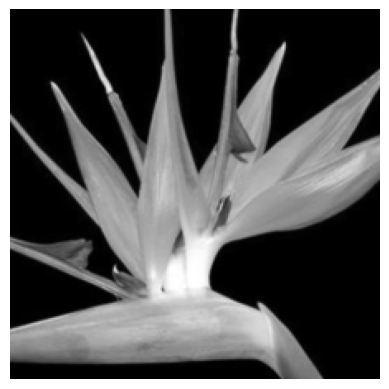

In [ ]:
imshow(sample_gray[0],True)

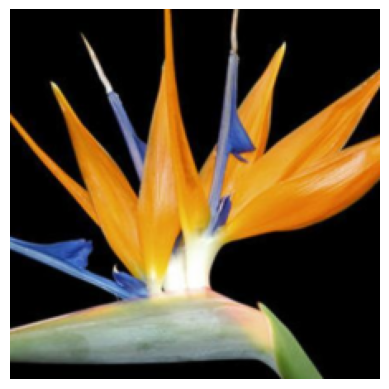

In [ ]:
imshow(sample_color[0])

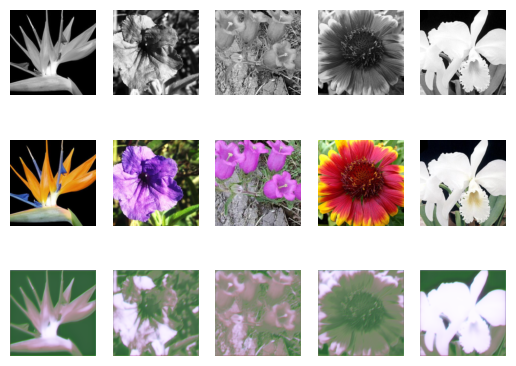

0 0.2172406017780304


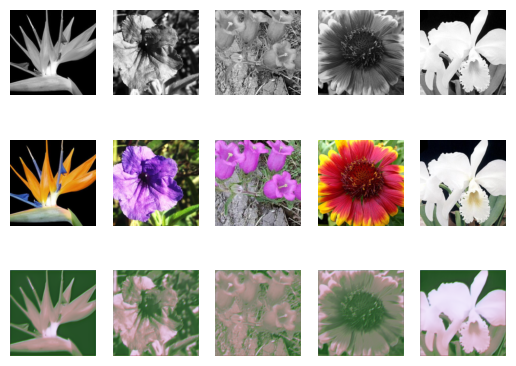

1 0.1557269016901652


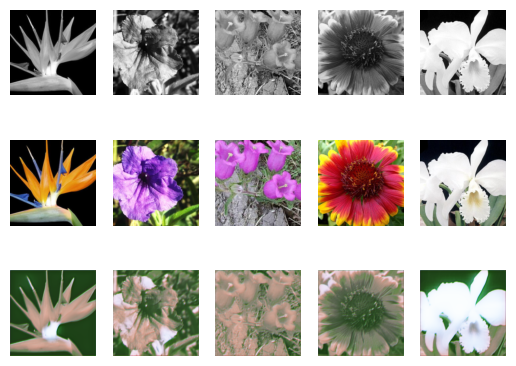

2 0.12615611801544827


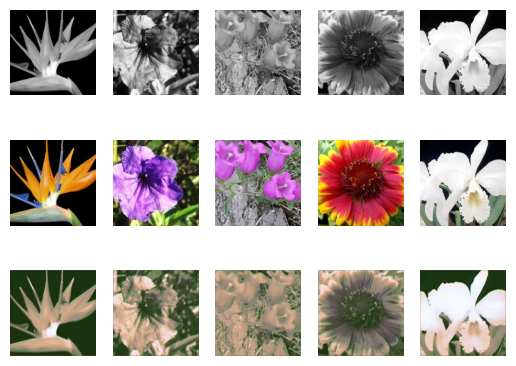

3 0.11273681471745173


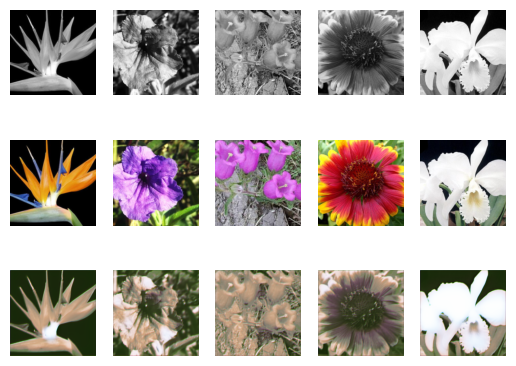

4 0.10513647645711899


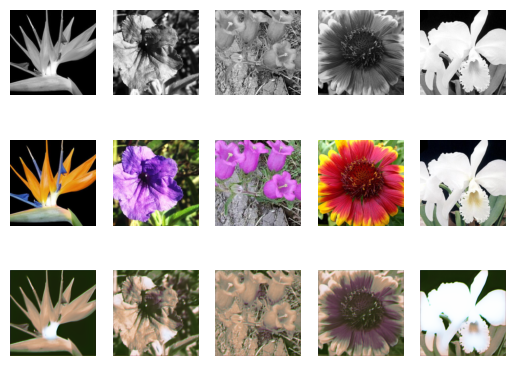

5 0.10158654451370239


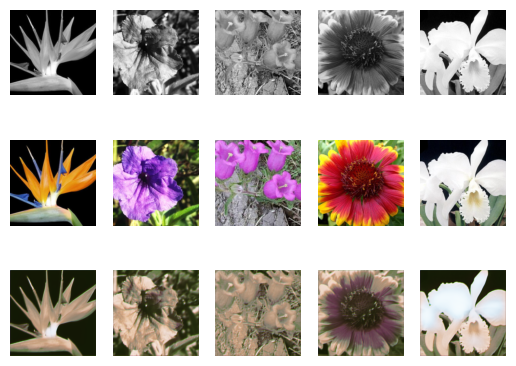

6 0.09479726354281108


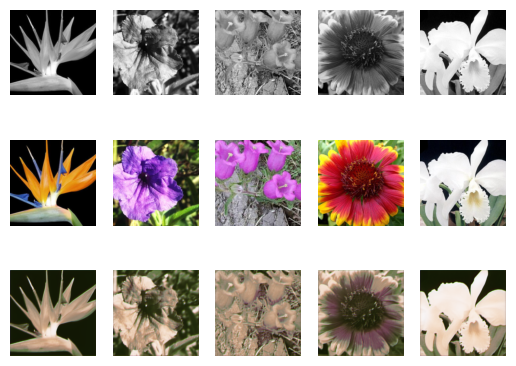

7 0.09923581431309382


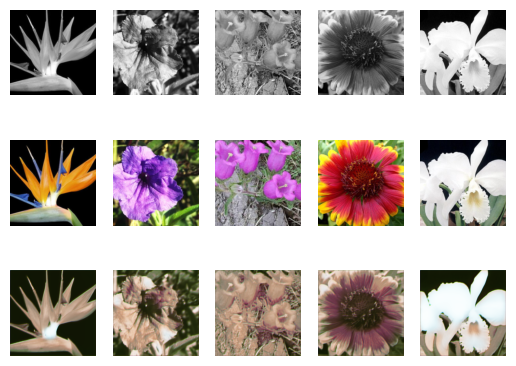

8 0.09134534597396851


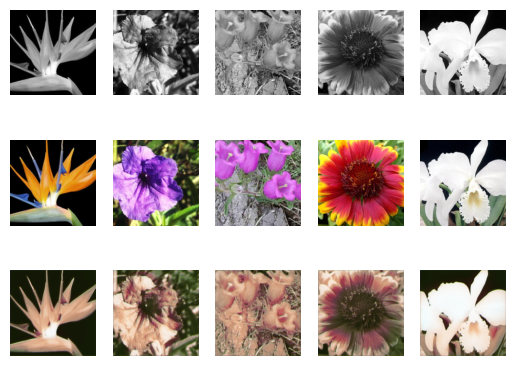

9 0.08760070651769639


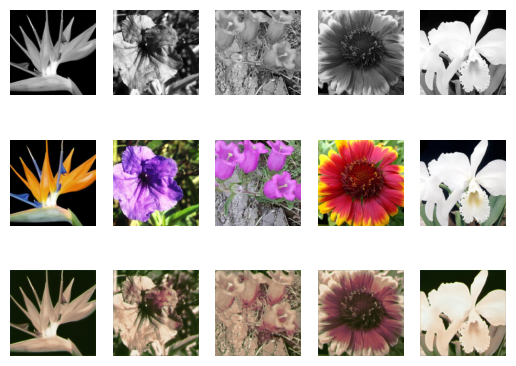

10 0.0872361863652865


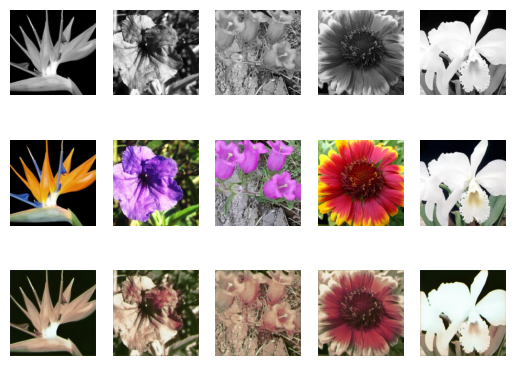

11 0.08394611676534017


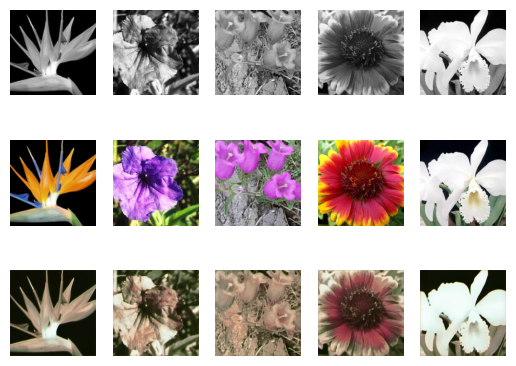

12 0.0874209443728129


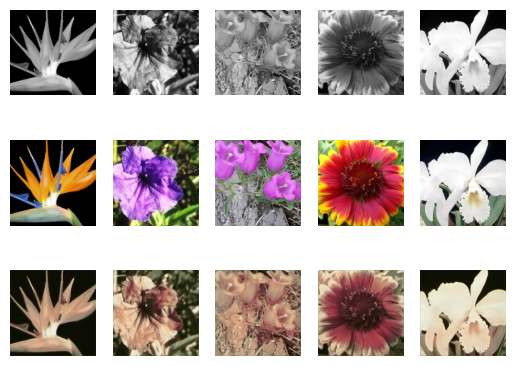

13 0.08845616082350413


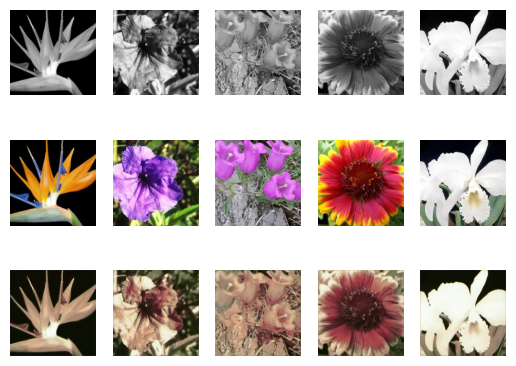

14 0.08078446338574091


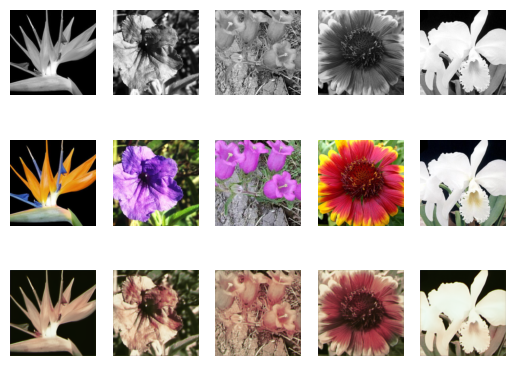

15 0.08114913205305735


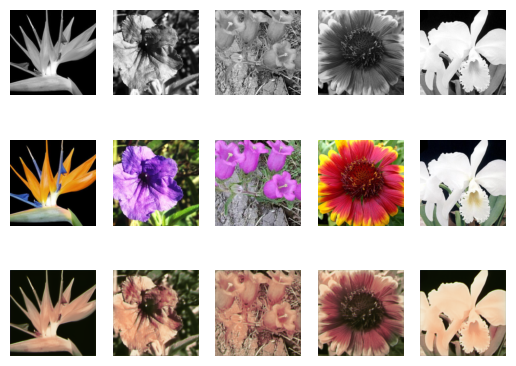

16 0.08209482754270235


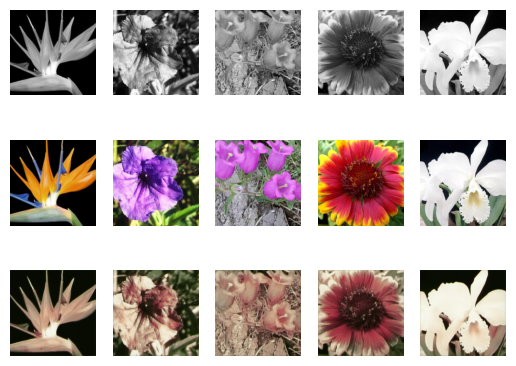

17 0.08460637082656225


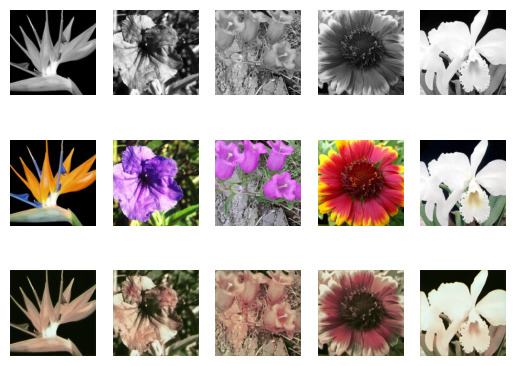

18 0.08123464236656824


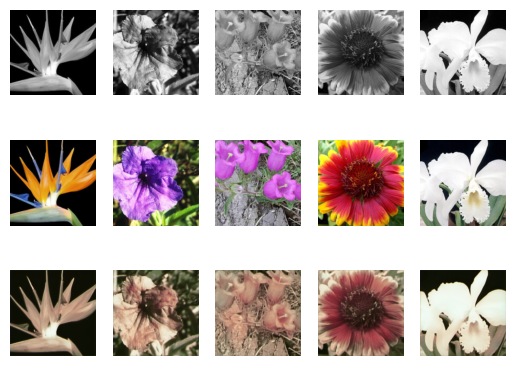

19 0.08057898332675298


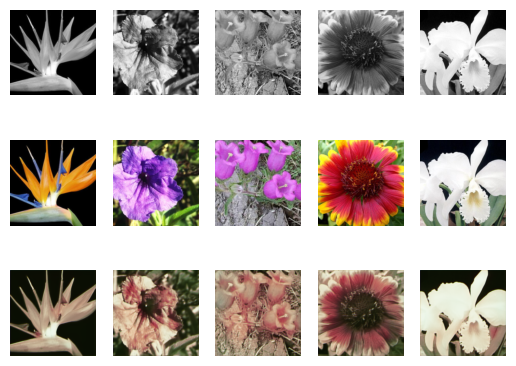

20 0.08052238846818606


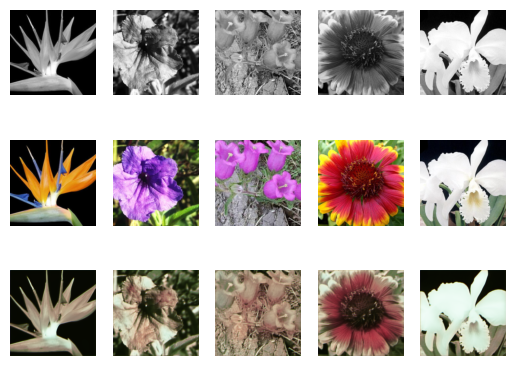

21 0.07936904579401016


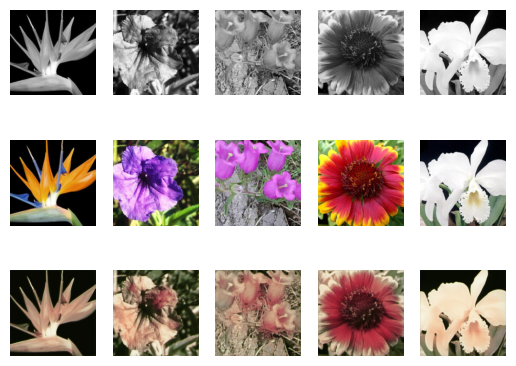

22 0.08095349917809168


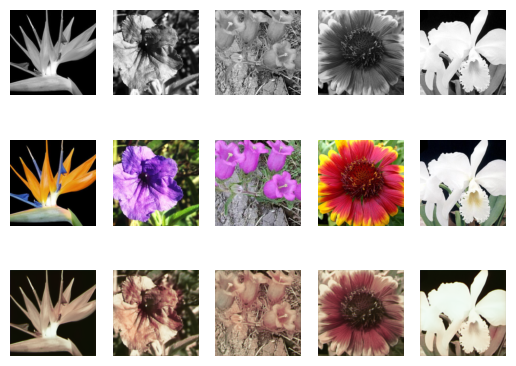

23 0.08380196144183477


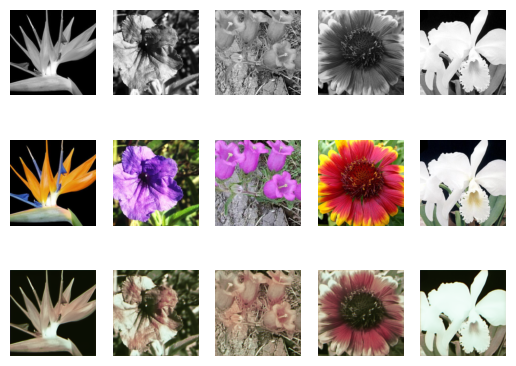

24 0.08222343077262242


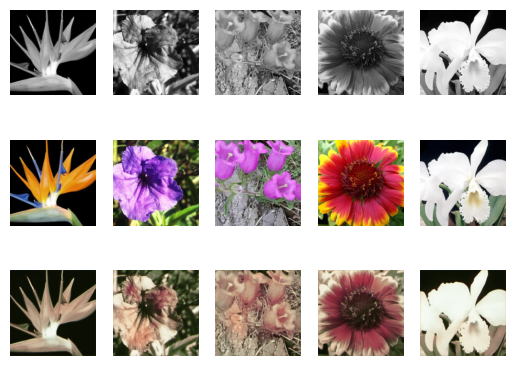

25 0.07743759776155154


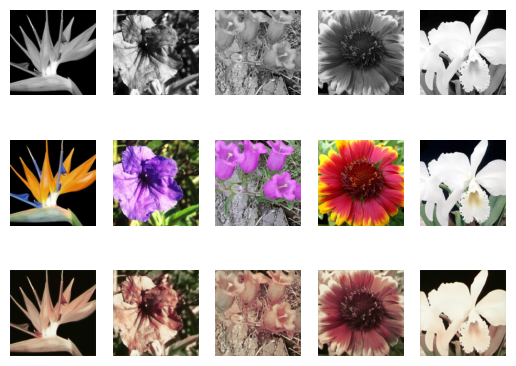

26 0.07931353896856308


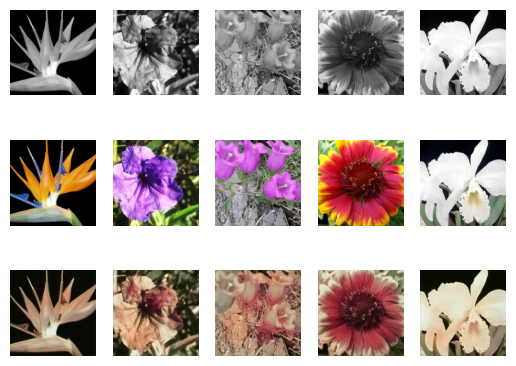

27 0.08800133764743805


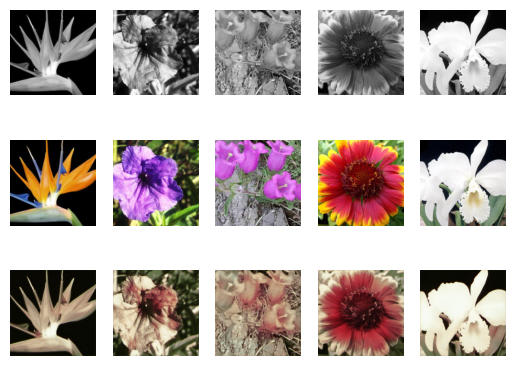

28 0.07749578580260277


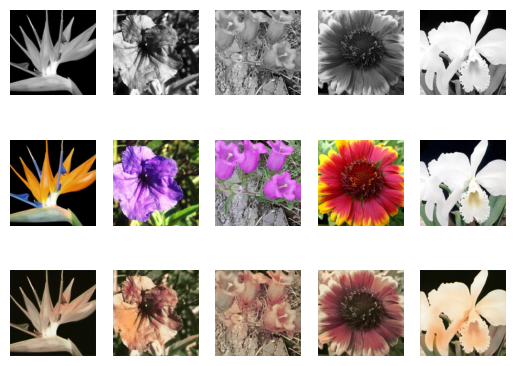

29 0.07782246967156728


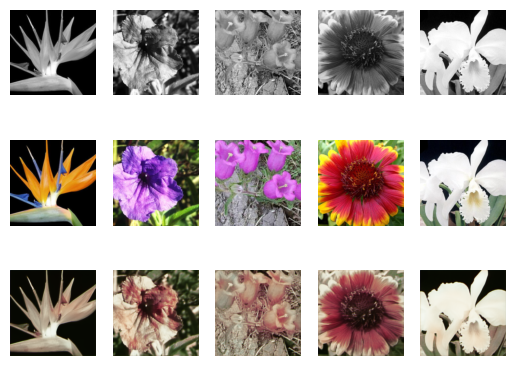

30 0.07822982197006544


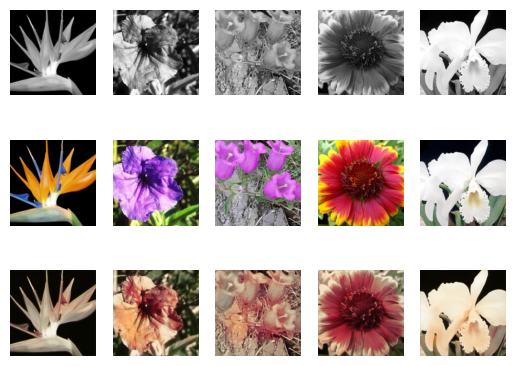

31 0.07690594643354416


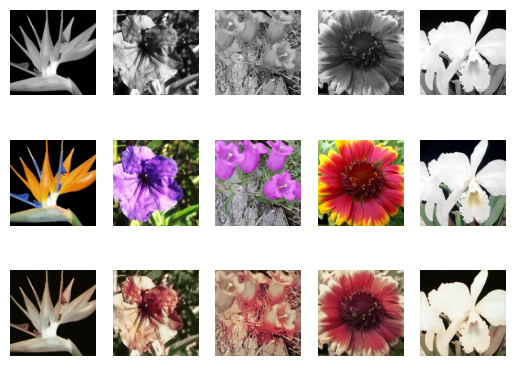

32 0.07920099645853043


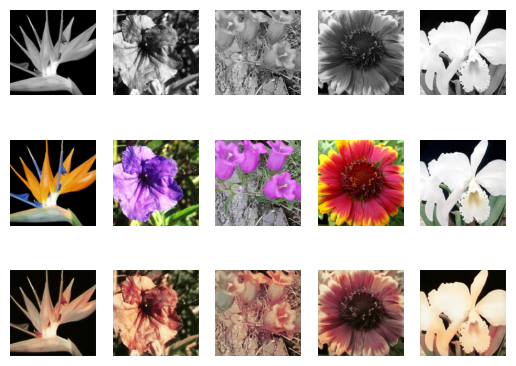

33 0.0816338633497556


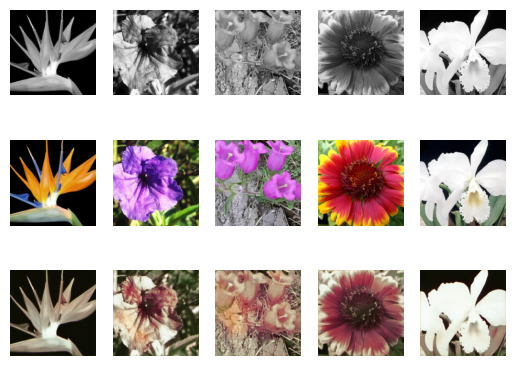

34 0.08148988634347916


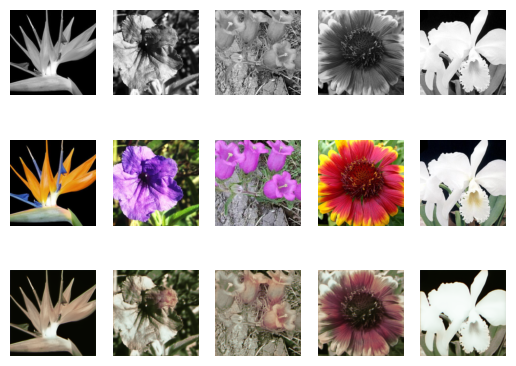

35 0.07775126844644546


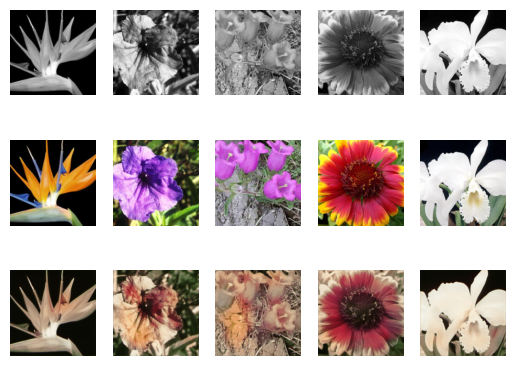

36 0.07696175451080005


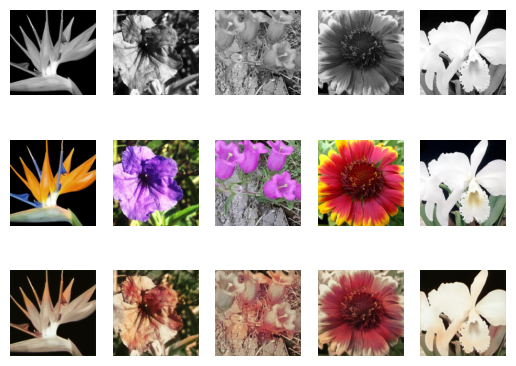

37 0.07597326834996541


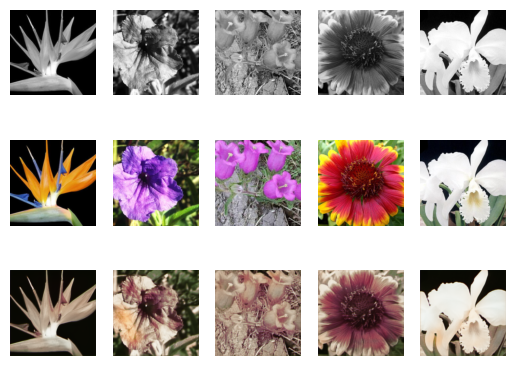

38 0.07730182359615961


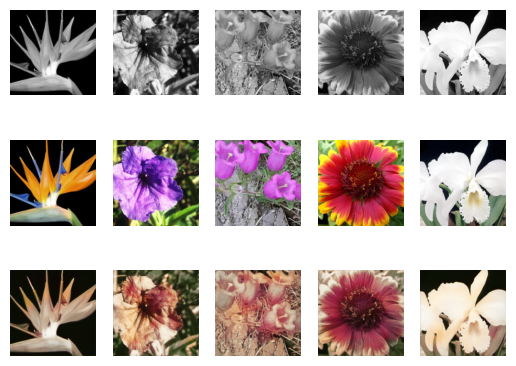

39 0.07760896707574526


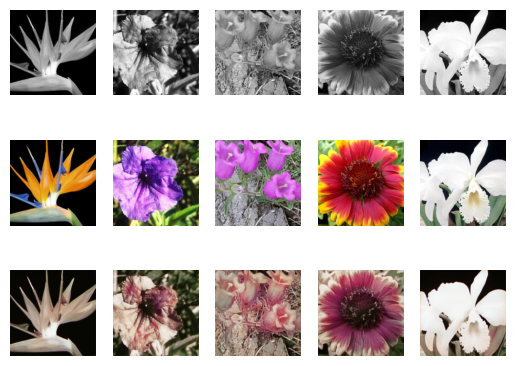

40 0.07860159228245417


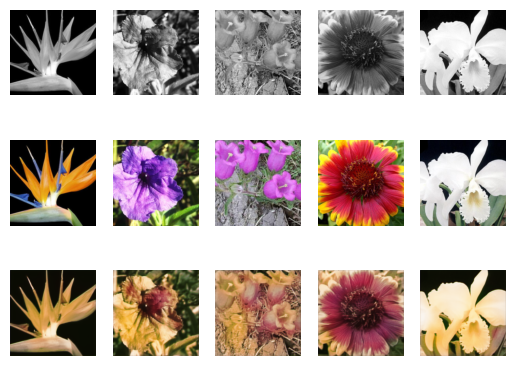

41 0.07593449975053469


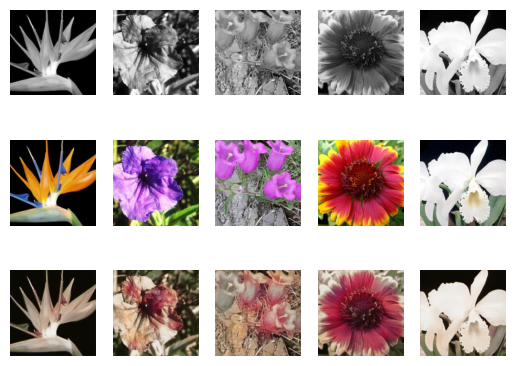

42 0.07628044262528419


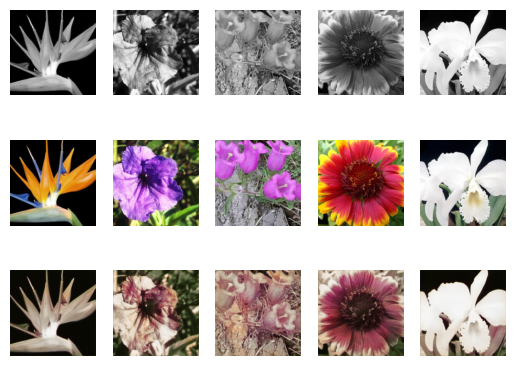

43 0.07724648291865985


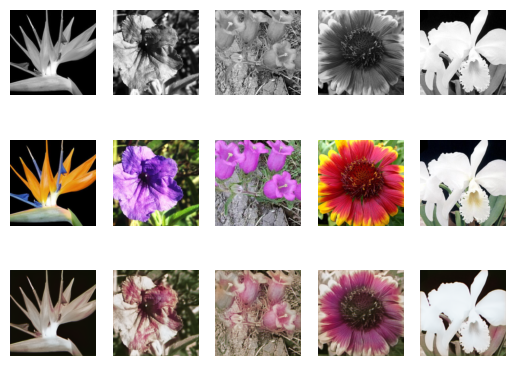

44 0.07632176031668982


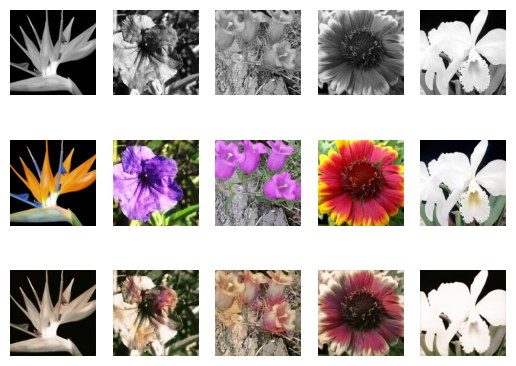

45 0.07699171031514804


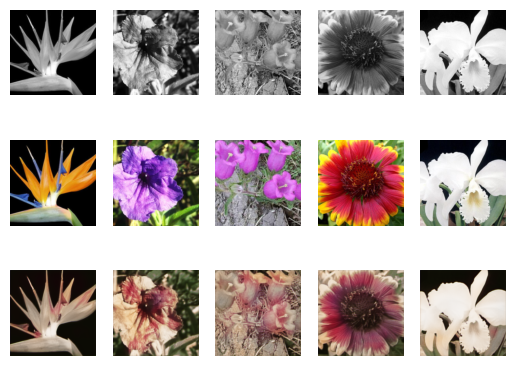

46 0.0765840192635854


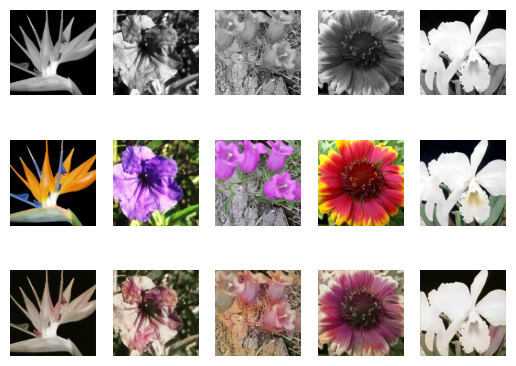

47 0.07343525861700376


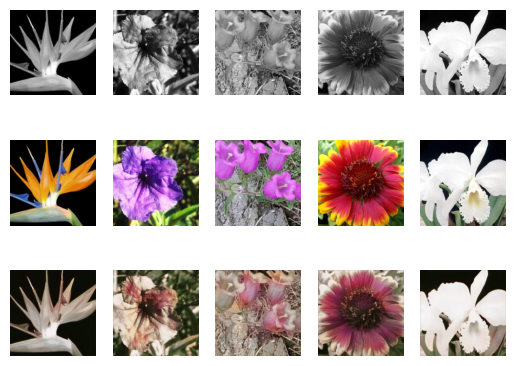

48 0.07094528004527093


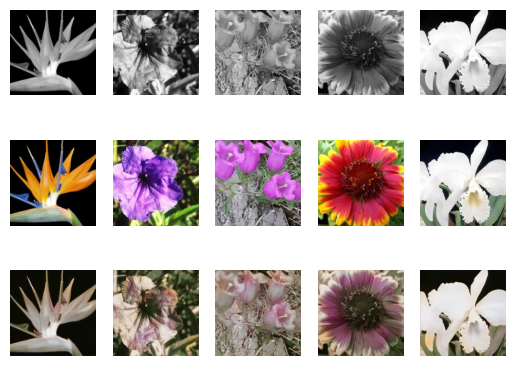

49 0.06923790077368418


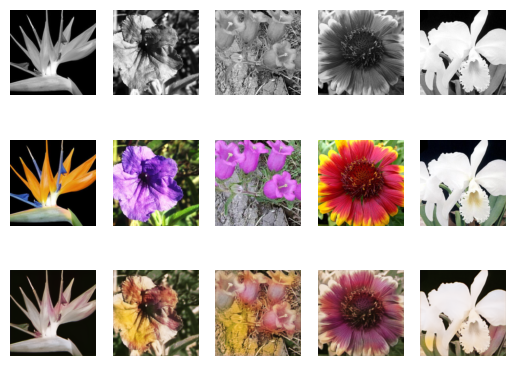

50 0.06907477950056394


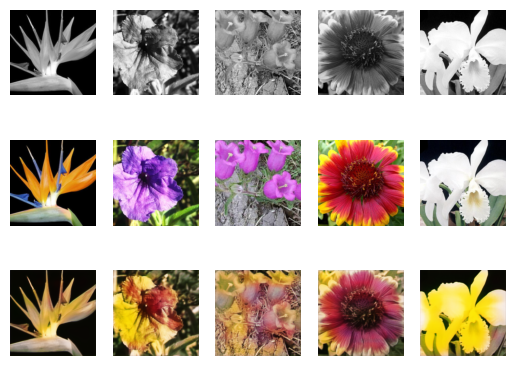

51 0.07271149580677351


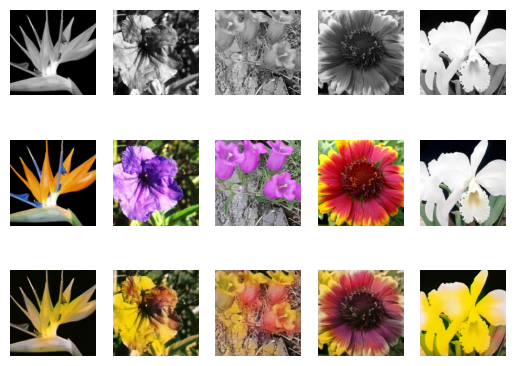

52 0.0721519780655702


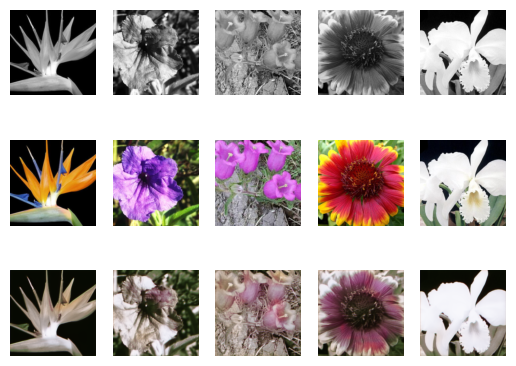

53 0.0802988866964976


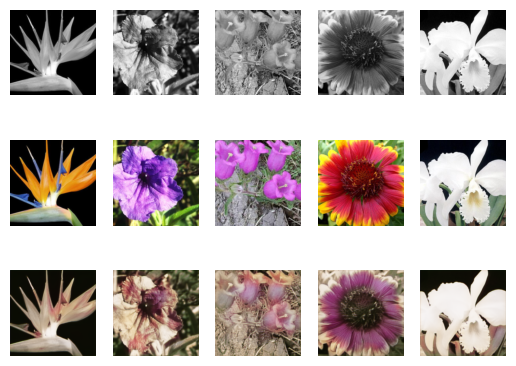

54 0.07655213673909506


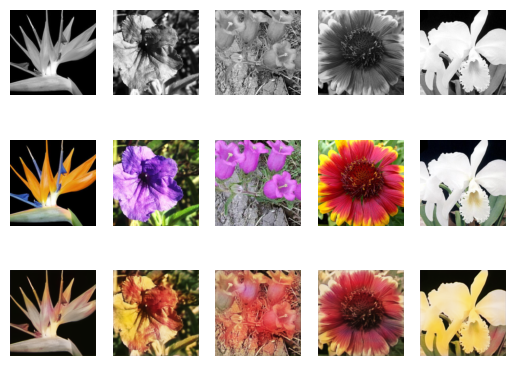

55 0.071084230641524


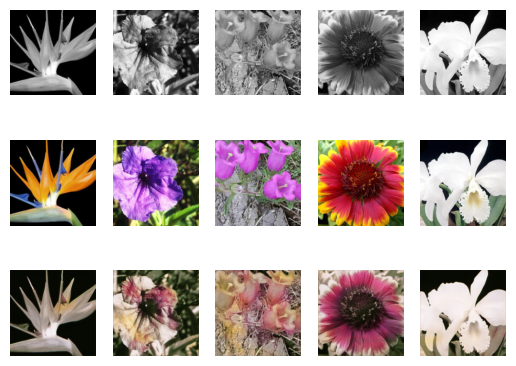

56 0.07411102180679639


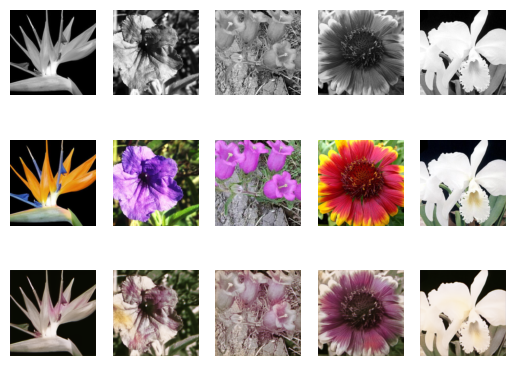

57 0.07350373243292173


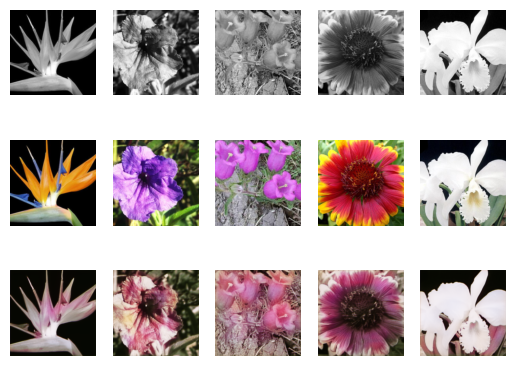

58 0.06999233365058899


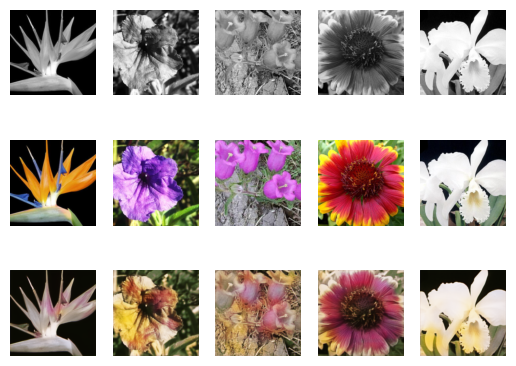

59 0.07055678144097328


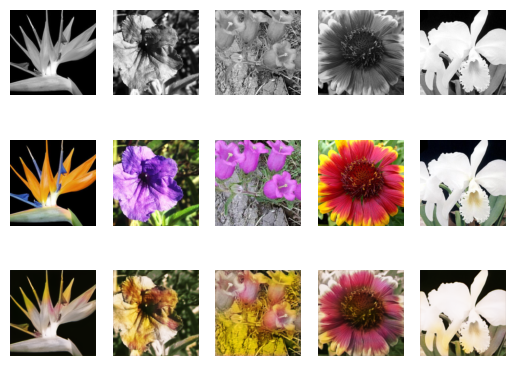

60 0.0658503606915474


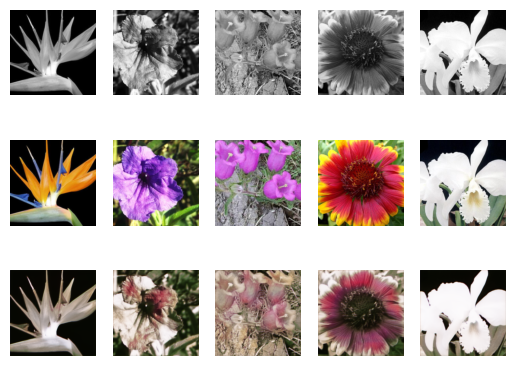

61 0.07648621499538422


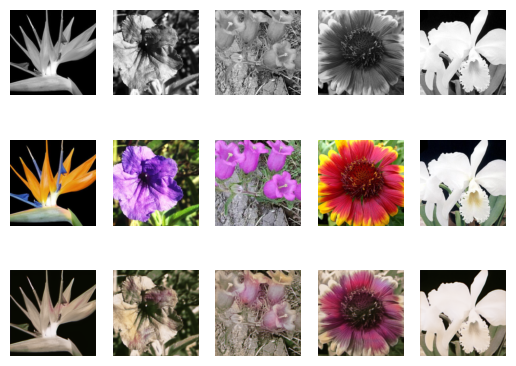

62 0.07188992152611415


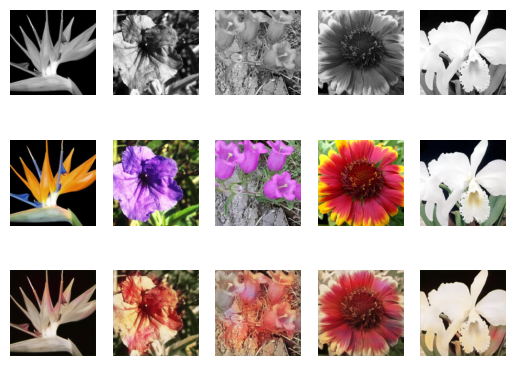

63 0.06512451420227687


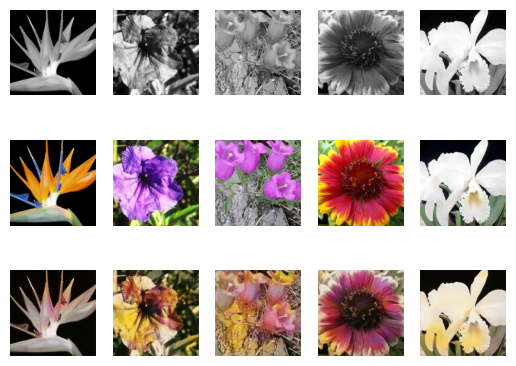

64 0.07090527961651484


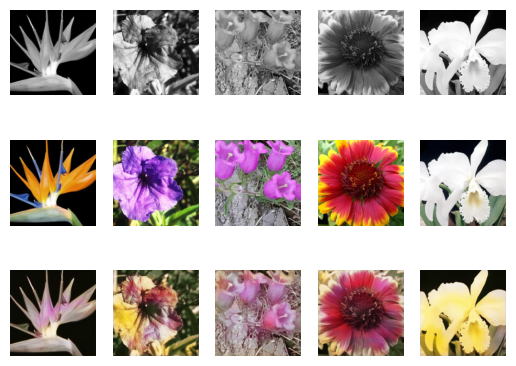

65 0.06684513737758001


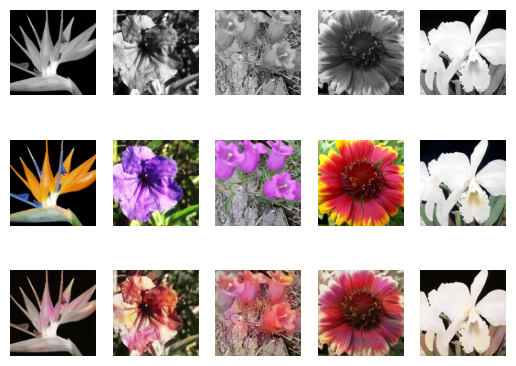

66 0.0656665379802386


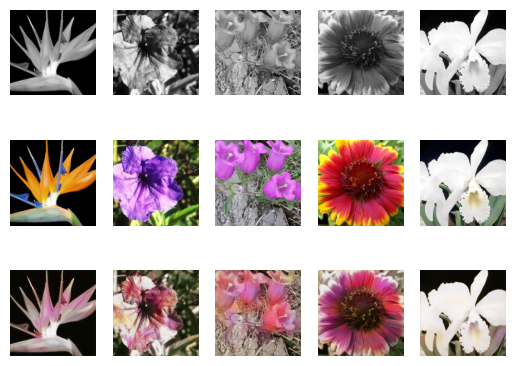

67 0.06322919552524885


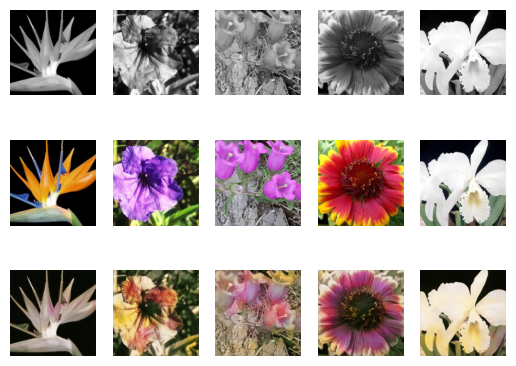

68 0.06515314827362696


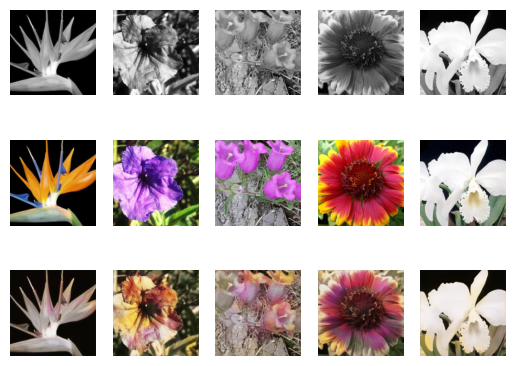

69 0.060986730207999544


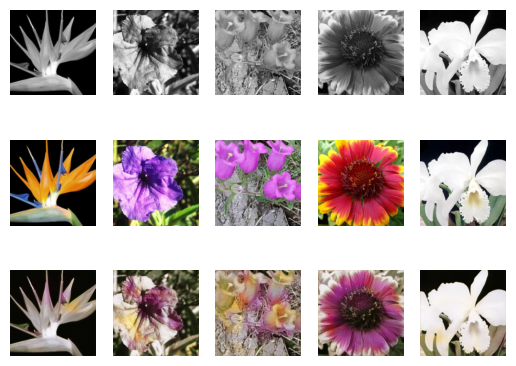

70 0.06361869970957439


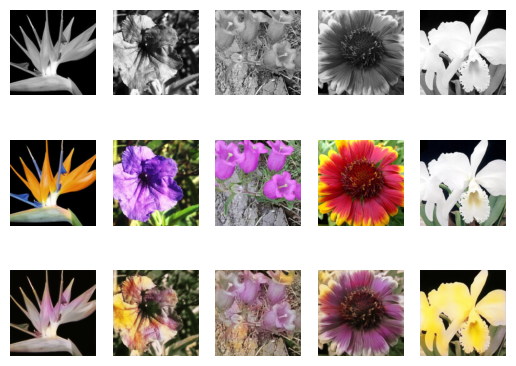

71 0.05996116126577059


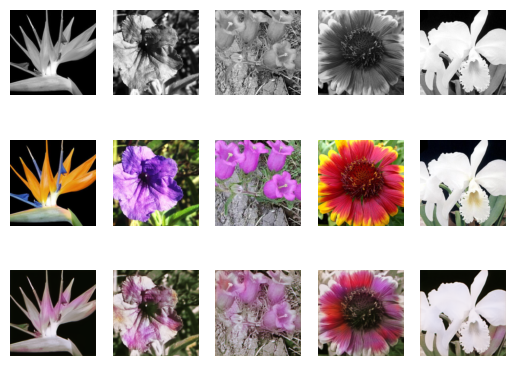

72 0.0581855408847332


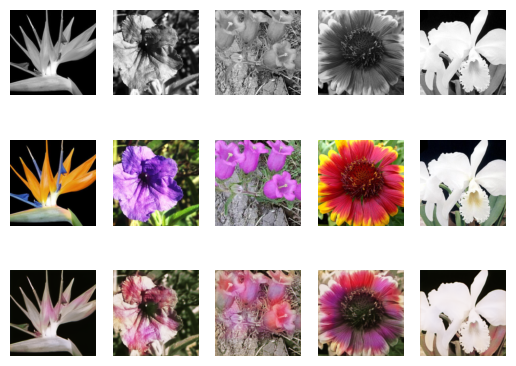

73 0.057425091663996376


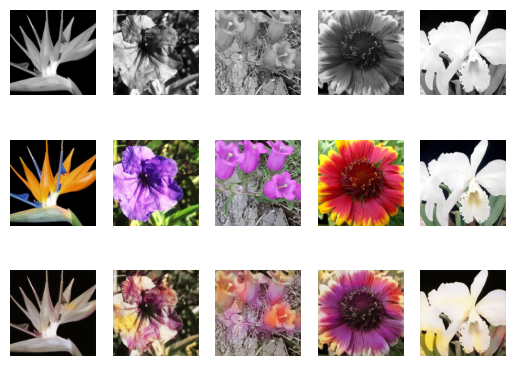

74 0.058762824287017186


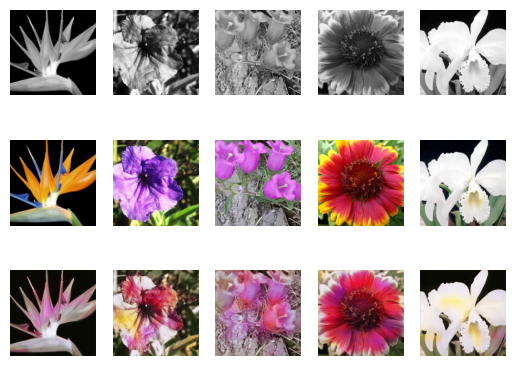

75 0.05901346405347188


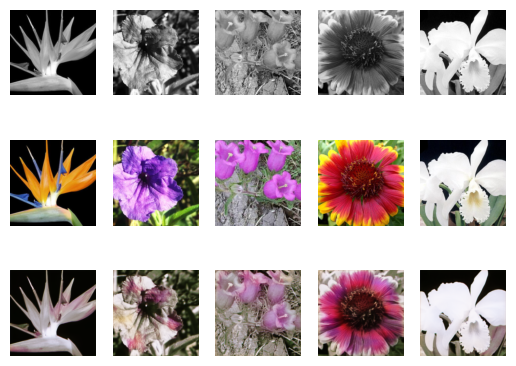

76 0.06569377655784289


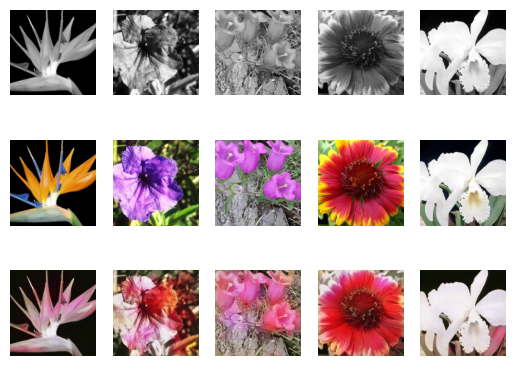

77 0.06082256684700648


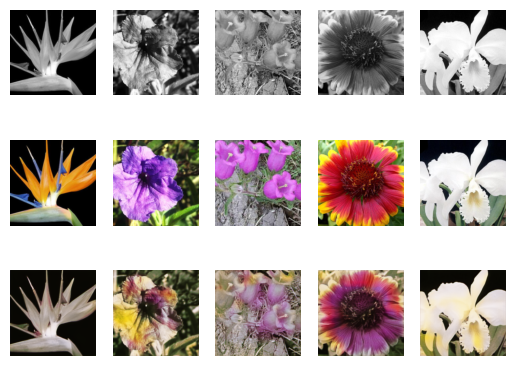

78 0.054642370094855626


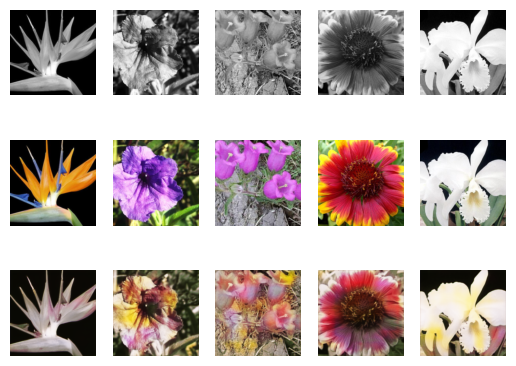

79 0.052248494078715645


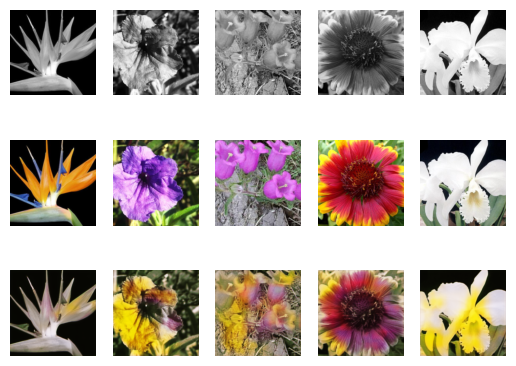

80 0.055006218453248344


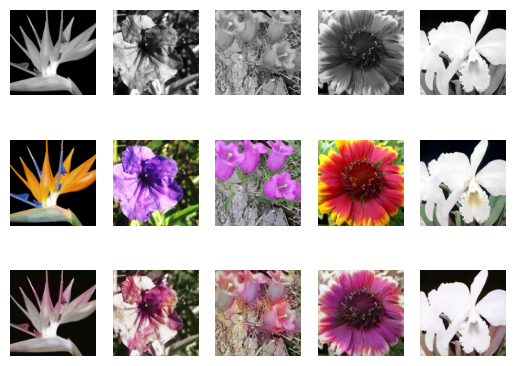

81 0.0635350652039051


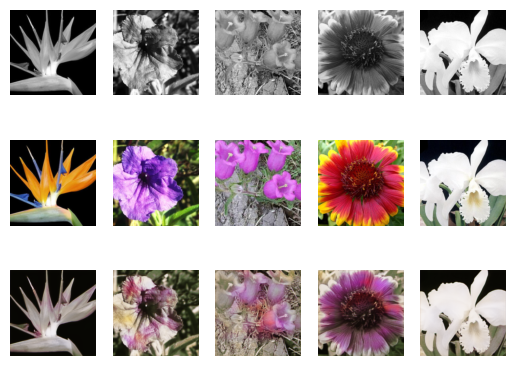

82 0.05989123558004697


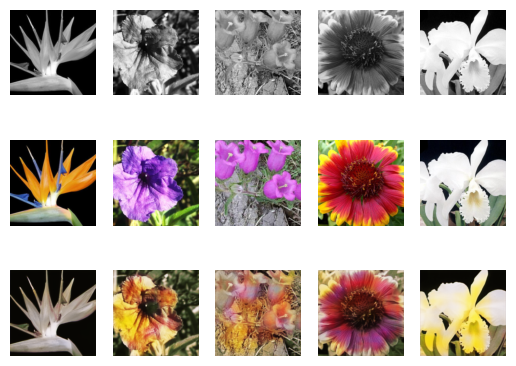

83 0.05670064985752106


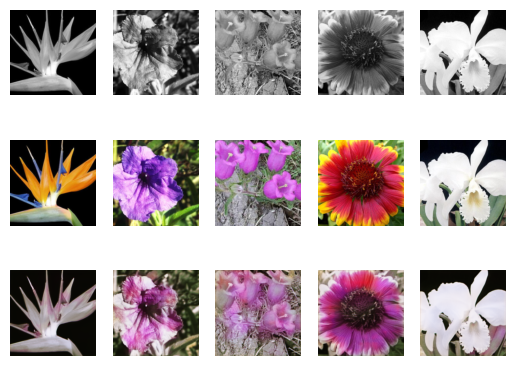

84 0.054143824925025306


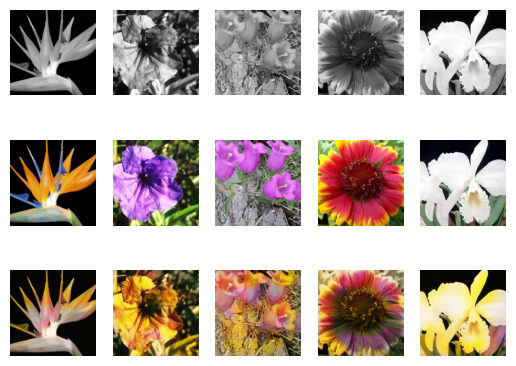

85 0.05991471583644549


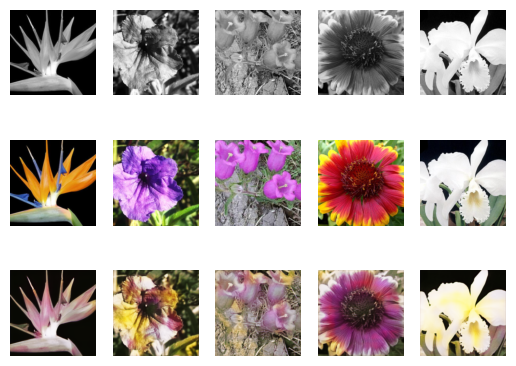

86 0.05830518181125323


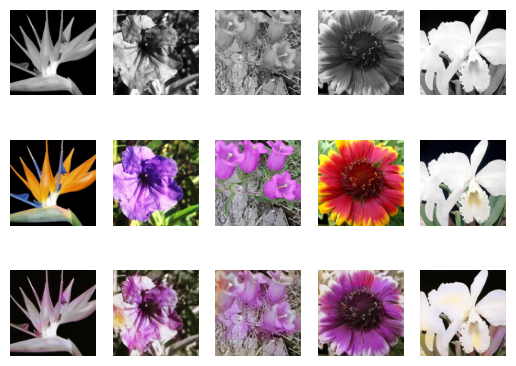

87 0.05463256438573202


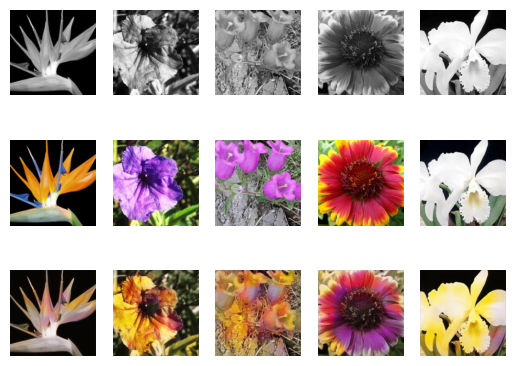

88 0.05382414211829503


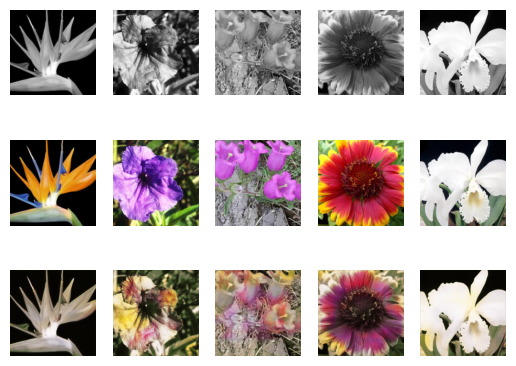

89 0.05490390881896019


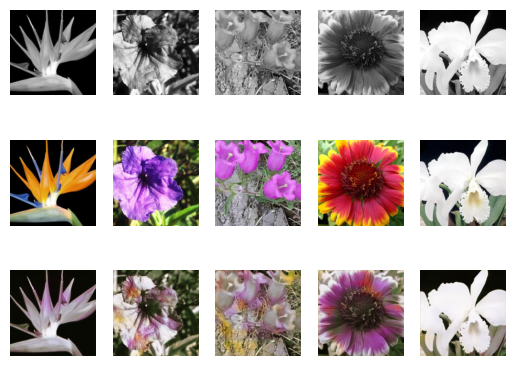

90 0.0509307973086834


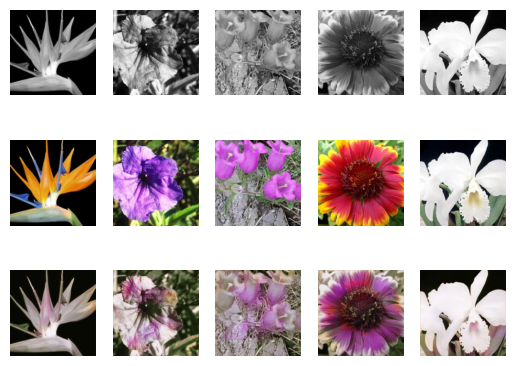

91 0.04954490140080452


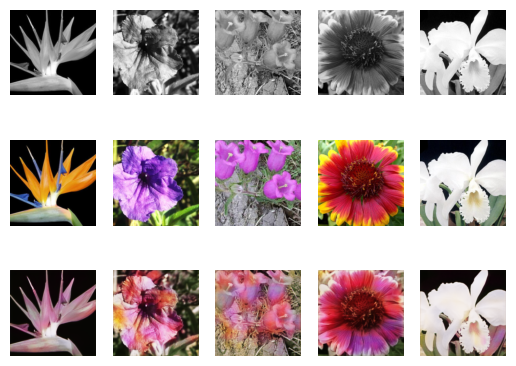

92 0.05429519737760226


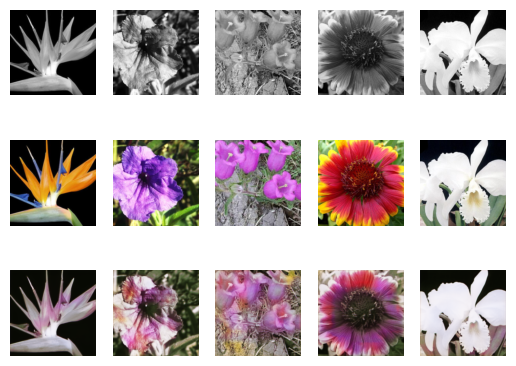

93 0.049611853311459224


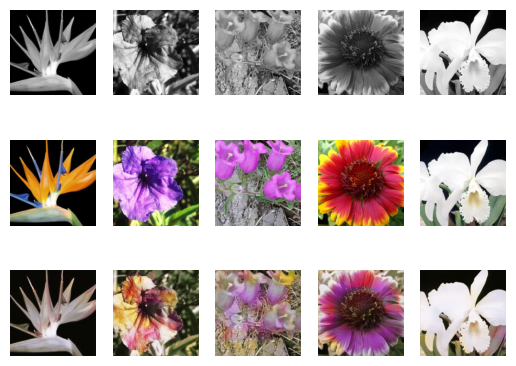

94 0.0474118356903394


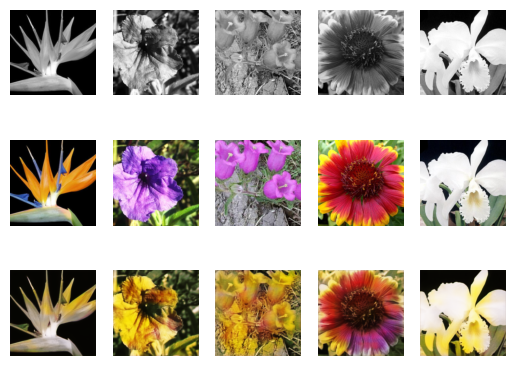

95 0.047115841507911684


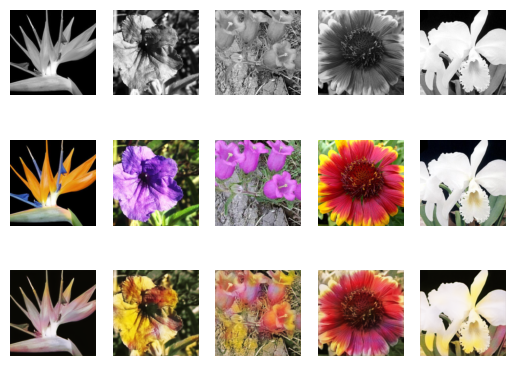

96 0.04716787586609523


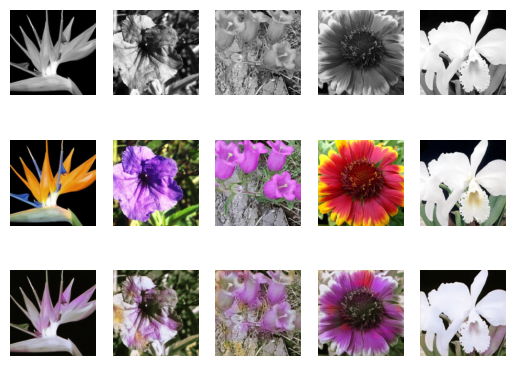

97 0.04675224696596463


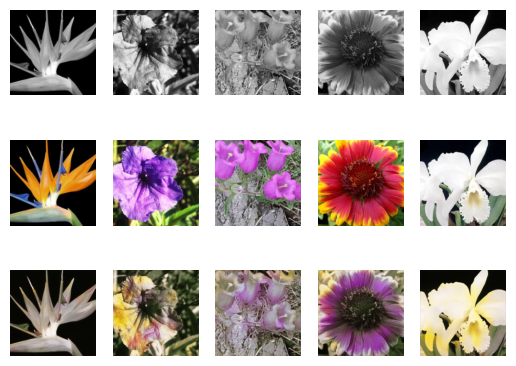

98 0.053838499387105304


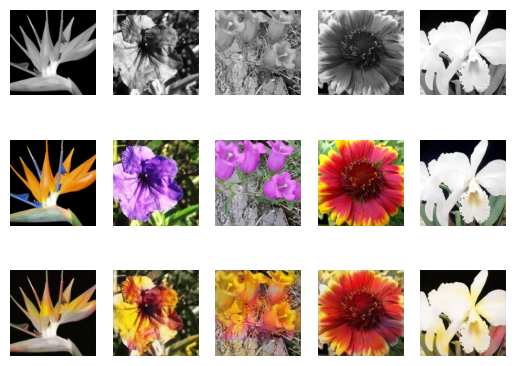

99 0.046478679527839024


In [ ]:
# LOSS FUNCTION
lr=0.0005
epochs=100

criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=lr)

train_losses = []
valid_losses = []
test_losses = []

#plt.figure(figsize=(15, 10))
n=5
for i in range(n):
        plt.subplot(3, n, i + 1)  # Display grayscale images in the first row
        imshow(sample_gray[i].cpu(), True)

        plt.subplot(3, n, i + 1 + n)  # Display sample color images in the second row
        imshow(sample_color[i].cpu())  # Assuming sample_color images are already in CPU and normalized


for epoch in range(epochs):
    # Train the Model
    total_loss = 0.0

    model.train()  # Change model to 'train' mode
    for i, (xs, ys) in enumerate(train_loader):

        images=xs.cuda()
        labels=ys.cuda()
        # Forward + Backward + Optimize
        optimizer.zero_grad()
        outputs = model(images)

        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
    average_loss = total_loss / len(train_loader)

    # Generate and display predictions after each epoch
    model.eval()
    with torch.no_grad():

        predicted_color_images = model(sample_gray.cuda())
        display_predictions(sample_gray, sample_color, predicted_color_images, n=5)
        valid_losses.append(test_unet(validation_loader))
        test_losses.append(test_unet(test_loader))

    train_losses.append(average_loss)

    print(epoch, average_loss)
    if epoch==20:
        # Save the model state and optimizer state
        state = {
            # 'epoch': epoch,
            'model_state': model.state_dict(),
            'optimizer_state': optimizer.state_dict(),
        }

        # Save to a file
        torch.save(state, 'model_checkpoint_rgb_complex_smalldataset_20.pth')
    if epoch==80:
        # Save the model state and optimizer state
        state = {
            # 'epoch': epoch,
            'model_state': model.state_dict(),
            'optimizer_state': optimizer.state_dict(),
        }

        # Save to a file
        torch.save(state, 'model_checkpoint_rgb_complex_smalldataset_80.pth')




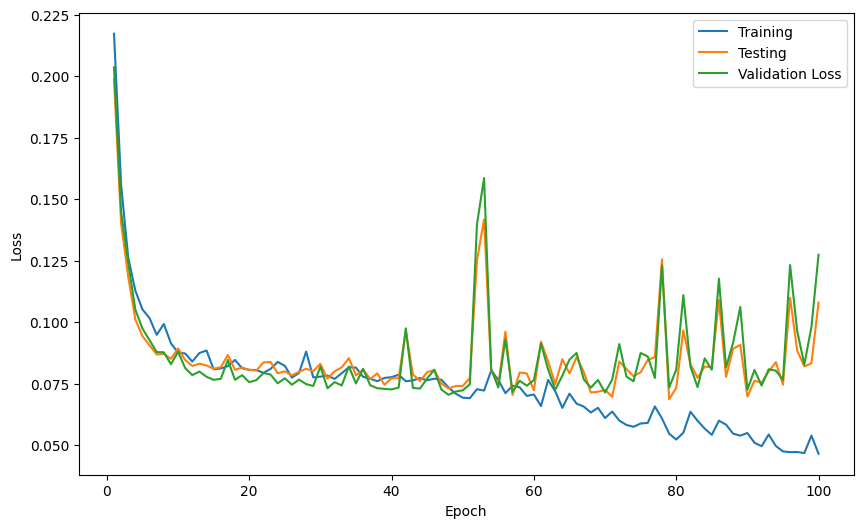

In [ ]:
plot_losses_unet(epochs,train_losses,test_losses, valid_losses)

In [ ]:
epoch = 30

In [ ]:
# Save the model state and optimizer state
state = {
    # 'epoch': epoch,
    'model_state': model.state_dict(),
    'optimizer_state': optimizer.state_dict(),
}

# Save to a file
torch.save(state, 'model_checkpoint_rgb_complex_largedataset_100.pth')

In [ ]:
# Load the state
state = torch.load('/content/model_checkpoint_rgb_complex_largedataset_100.pth')

# Restore the model and optimizer state
model.load_state_dict(state['model_state'])
# optimizer.load_state_dict(state['optimizer_state'])

# Continue training from the epoch and loss where you left off
# epoch = state['epoch']


<All keys matched successfully>

In [ ]:
def display_predictions_test(grayscale, sample_color, predicted, n,name):
    #plt.figure(figsize=(15, 10))

    for i in range(n):
        plt.subplot(3, n, i + 1)  # Display grayscale images in the first row
        imshow(grayscale[i].cpu(), True)

        plt.subplot(3, n, i + 1 + n)  # Display sample color images in the second row
        imshow(sample_color[i].cpu())  # Assuming sample_color images are already in CPU and normalized

        plt.subplot(3, n, i + 1 + 2 * n)  # Display predicted color images in the third row
        imshow(predicted[i].cpu())  # Assuming predicted images are already in CPU and normalized
    plt.savefig(f'{name}.png')
    plt.show()

In [ ]:
data_iter = iter(test_loader)


In [ ]:
sample_gray, sample_color = next(data_iter)

In [ ]:
sample_gray, sample_color = sample_gray[:5], sample_color[:5]

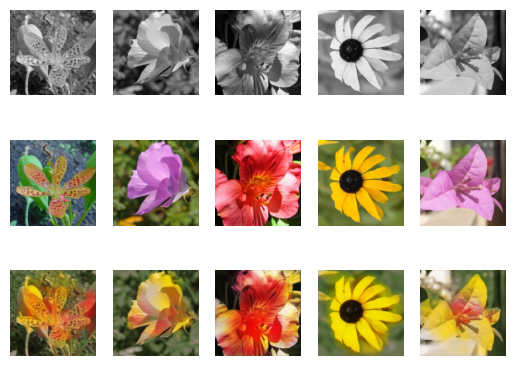

In [ ]:
# Generate and display predictions after each epoch
model.eval()
with torch.no_grad():

    predicted_color_images = model(sample_gray.cuda())
    display_predictions_test(sample_gray, sample_color, predicted_color_images, 5,'train4')